# Intro to Bartiq


2025-08-31 IEEE Quantum Week, Albuquerque, NM

Authors:
- Konrad Jałowiecki
- Mariia Mykhailova
- Michał Stęchły
- Brendan Reid


## What problems do we solve?

We build tools which enable getting QREs as expressions instead of raw numbers.

What it enables in practice:

- You have read the latest paper from group X and want to quickly model and reproduce their results (see our [Alias Sampling tutorial](https://github.com/PsiQ/bartiq/blob/main/docs/tutorials/02_alias_sampling_basic.ipynb)).

- You want to understand the scaling of a complicated algorithm (2nd session)

- You want to generate hundreds of QREs fast (2nd session)

## What is QREF?

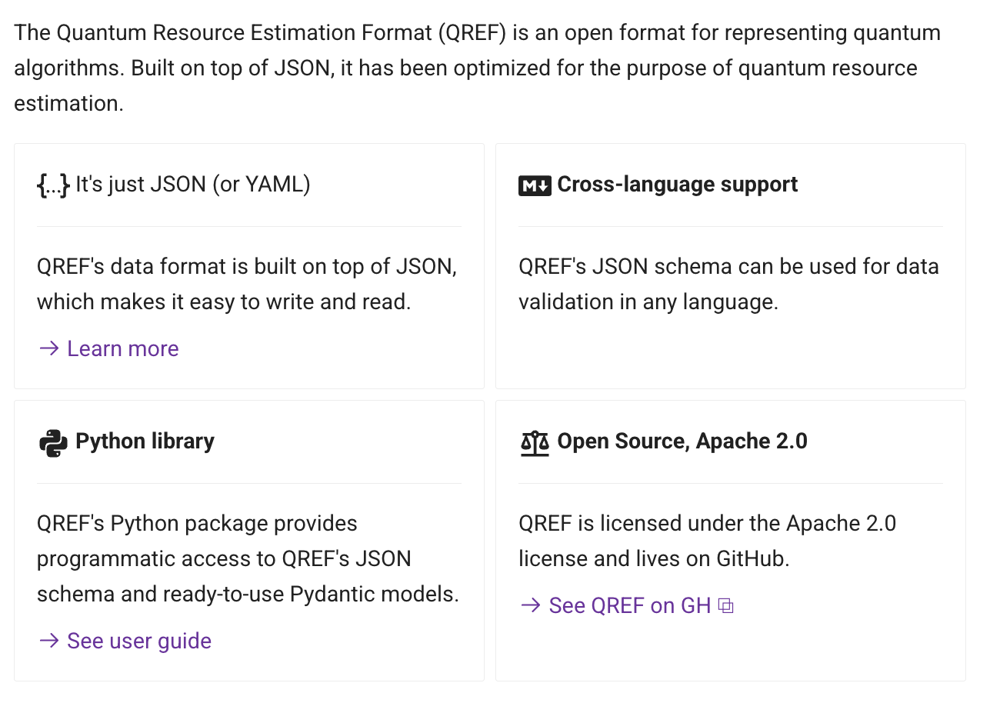

## QREF vs Bartiq

| QREF | Bartiq|
|------|--------|
| Serialization format | Library |
| Lives mostly as a JSON/YAML file | You can analyze and modify the Python objects |
| One format | Different classes representing different objects |
| Doesn't know about Bartiq | Bartiq can use QREF objects as inputs / outputs|

## Data structures in Bartiq

The fundamental data structure in Bartiq is `Routine`. 

For this tutorial, it's most important properties are:
- `children`
- `resources`
- `ports`
- `input_params`

Let's take a look at how it looks like for a particular routine:

In [1]:
import yaml
from bartiq import Routine, sympy_backend

with open("alias_sampling_example.yaml", "r") as f:
    raw_data = yaml.safe_load(f)

routine = Routine.from_qref(raw_data, backend=sympy_backend)

Babbush et al. in [Encoding Electronic Spectra in Quantum Circuits with Linear T Complexity](https://journals.aps.org/prx/abstract/10.1103/PhysRevX.8.041015). 

![Alias Sampling](../../images/alias_sampling_paper.png)

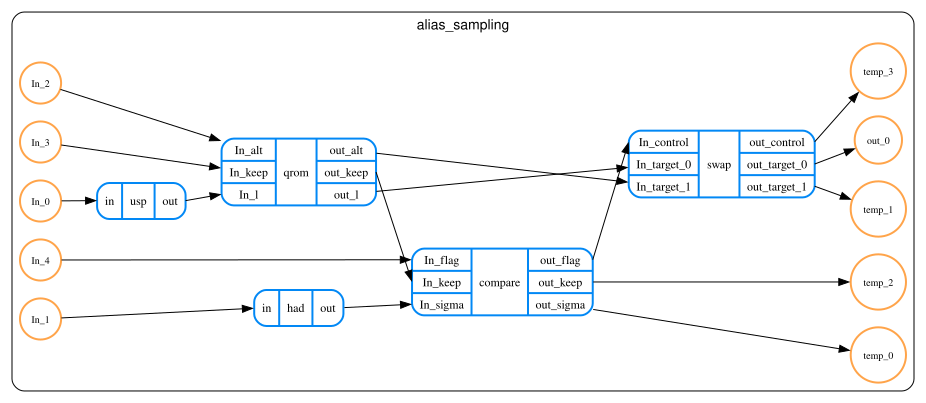

In [23]:
from qref.experimental.rendering import to_graphviz

# Convert the qref format to Graphviz object
to_graphviz(raw_data)

In [3]:
routine.children.keys()

dict_keys(['usp', 'had', 'qrom', 'compare', 'swap'])

In [4]:
routine.children["usp"]

Routine(name='usp', type=None, children={}, ports={'in': Port(name='in', direction='input', size=R), 'out': Port(name='out', direction='output', size=R)}, resources={'T_gates': Resource(name='T_gates', type=<ResourceType.additive: 'additive'>, value=8*ceiling(log2(L/2**multiplicity(2, L))) - 8), 'rotations': Resource(name='rotations', type=<ResourceType.additive: 'additive'>, value=2)}, connections={}, repetition=None, constraints=(), children_order=(), input_params=['L'], linked_params={}, local_variables={'R': ceiling(log2(L))})

In [6]:
routine.children["usp"].resource_values

{'T_gates': 8*ceiling(log2(L/2**multiplicity(2, L))) - 8, 'rotations': 2}

In [7]:
routine.children["usp"].ports

{'in': Port(name='in', direction='input', size=R),
 'out': Port(name='out', direction='output', size=R)}

In [8]:
routine.children["usp"].input_params

['L']

## Lifecycle of a routine

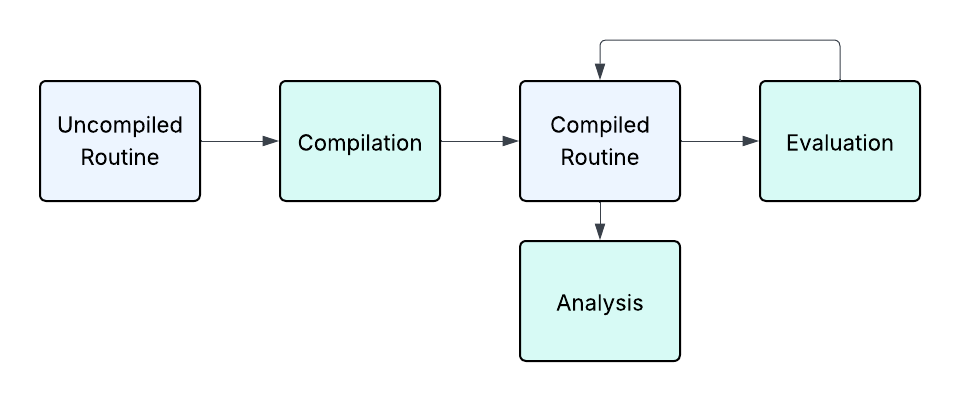

Here I present a shortened version of the [the basic example](https://github.com/PsiQ/bartiq/blob/main/docs/tutorials/01_basic_example.ipynb), if you're reading this, please skip this section and refer to that notebook as it's more complete.

![title](../../images/basic_example.png)

In [9]:
my_algorithm = {
    "name": "my_algorithm",
    "type": None,
    "ports": [
        {"name": "in", "direction": "input", "size": "n"},
        {"name": "out", "direction": "output", "size": None},
    ],
}

In [10]:
routine_a = {
    "name": "A",
    "type": None,
    "ports": [
        {"name": "in", "direction": "input", "size": "n_a"},
        {"name": "out", "direction": "output", "size": "2*n_a"},
    ],
}

In [11]:
routine_b = {
    "name": "B",
    "type": None,
    "ports": [
        {"name": "in", "direction": "input", "size": "n_b"},
        # "y" will be defined in the next step
        {"name": "out", "direction": "output", "size": "n_b + y"},
    ],
}

![title](../../images/basic_children.png)


In [12]:
# Define T-gate counts for routine a
routine_a["input_params"] = ["x"]
routine_a["resources"] = [{"name": "T_gates", "type": "additive", "value": "2*n_a + x"}]

# Define T-gate counts for routine b
routine_b["input_params"] = ["y"]
routine_b["resources"] = [{"name": "T_gates", "type": "additive", "value": "n_b*ceiling(log2(n_b)) * y"}]

In [13]:
my_algorithm["children"] = [routine_a, routine_b]
my_algorithm["connections"] = [
    {"source": "in", "target": "A.in"},
    {"source": "A.out", "target": "B.in"},
    {"source": "B.out", "target": "out"},
]
my_algorithm["input_params"] = ["z"]
my_algorithm["linked_params"] = [{"source": "z", "targets": ["A.x", "B.y"]}]

In [14]:
from qref import SchemaV1
my_algorithm_qref_dict = {"version": "v1", "program": my_algorithm}

my_algorithm_qref = SchemaV1(**my_algorithm_qref_dict)

 Below you can find depiction of the uncompiled version of `my_algorithm`.
![title](../../images/basic_uncompiled.png)

What we want to do is to get to the following picture:
![title](../../images/basic_compiled.png)

In [18]:
from bartiq import compile_routine
from bartiq.compilation import CompilationFlags

compiled_routine = compile_routine(my_algorithm_qref, compilation_flags=CompilationFlags.EXPAND_RESOURCES).routine

compiled_routine.resource_values

{'T_gates': 2*n*z*ceiling(log2(2*n)) + 2*n + z}

In [20]:
from bartiq import evaluate

print("Different values of n:")
for n in range(6, 16, 2):
    assignments = {"n": n}
    evaluated_routine = evaluate(compiled_routine, assignments).routine
    print(f"\tn = {n}, total #T-gates:", evaluated_routine.resources["T_gates"].value)

Different values of n:
	n = 6, total #T-gates: 49*z + 12
	n = 8, total #T-gates: 65*z + 16
	n = 10, total #T-gates: 101*z + 20
	n = 12, total #T-gates: 121*z + 24
	n = 14, total #T-gates: 141*z + 28


In [21]:
z = 5
assignments = {"n": n, "z": z}
evaluated_routine = evaluate(compiled_routine, assignments).routine

print(f"\nFor (n={n}, z={z}) total #T-gates:", evaluated_routine.resources["T_gates"].value)


For (n=14, z=5) total #T-gates: 733


## Bartiq's limitations

Limitations:
- Limited tools for authoring (e.g.: Workbench and Qualtran)
- Balance between exact and approximate costs
- Works only at the logical level

## Qualtran integration

We have written [QREF - Qualtran integration](https://github.com/quantumlib/Qualtran/tree/main/qualtran/qref_interop).

- It's a proof of concept
- If you'd like to try it out, please give us feedback!

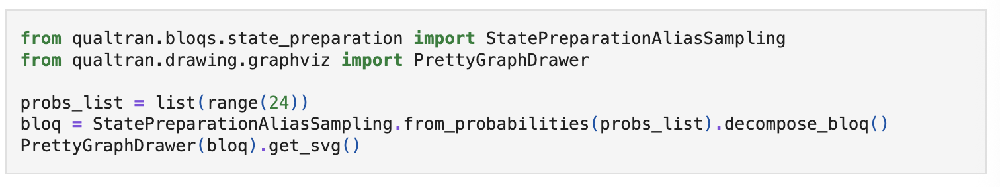

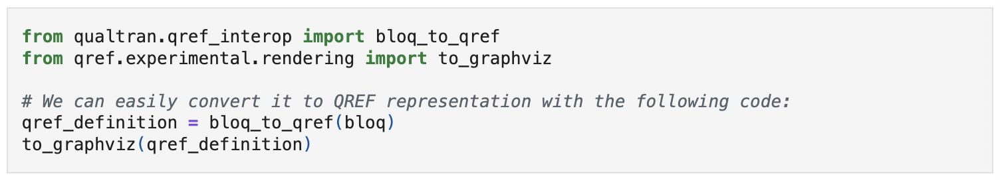

## Why is Bartiq open source?

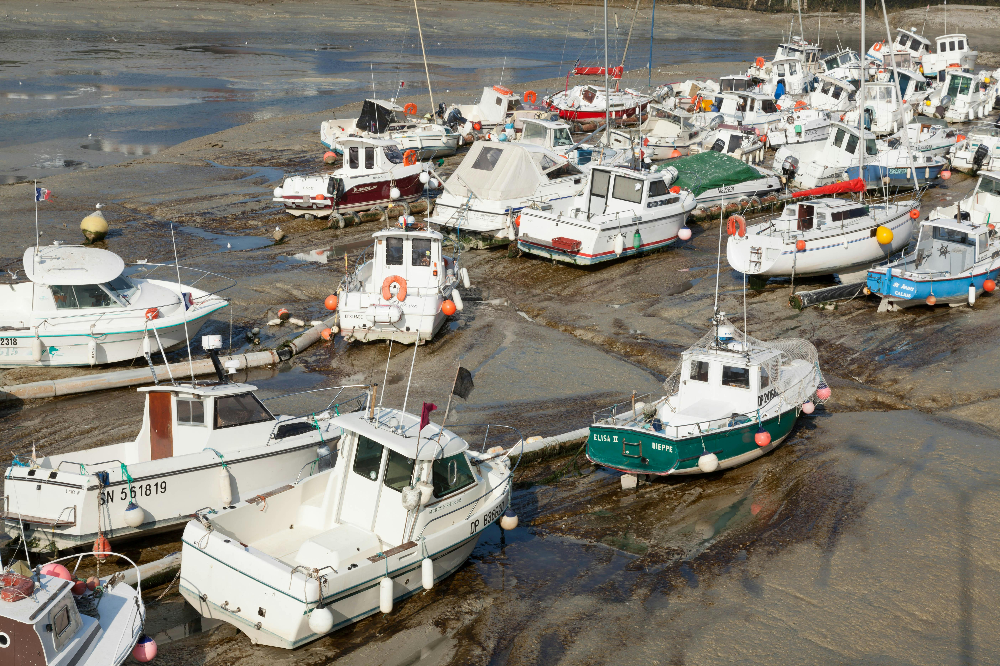

## Feedback

- We're a small development team and we'd love to hear your feedback!
- If you have a project where Bartiq looks like a good fit – let us know!
- You can have real impact on the development of the tool


# THANK YOU!